<a href="https://www.kaggle.com/code/abhigyan2004/gb-detection-yolo?scriptVersionId=247270476" target="_blank"><img align="left" alt="Kaggle" title="Open in Kaggle" src="https://kaggle.com/static/images/open-in-kaggle.svg"></a>

In [1]:
###############################################################################
# PART 1: Imports, Dataset Loading, and Basic Preprocessing
###############################################################################

import os
import json
import math
import numpy as np
import cv2
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow.keras.models import Model
from tensorflow.keras.layers import (Input, Conv2D, BatchNormalization, Activation, Add, 
                                     UpSampling2D, Concatenate, GlobalAveragePooling2D, Dense, 
                                     Dropout)
from tensorflow.keras.callbacks import ReduceLROnPlateau, ModelCheckpoint, EarlyStopping
from tensorflow.keras.regularizers import l2
from sklearn.model_selection import train_test_split
from sklearn.metrics import (confusion_matrix, ConfusionMatrixDisplay, f1_score, 
                             precision_score, recall_score, accuracy_score)
# If needed: from imblearn.over_sampling import SMOTE

# For reproducibility
np.random.seed(42)
tf.random.set_seed(42)

###############################################################################
# ADJUST THESE PATHS as per your environment
###############################################################################
DATA_PATH = "/kaggle/input/gbcu-data/GBCU-Shared"  # or wherever your data is
IMAGE_PATH = os.path.join(DATA_PATH, "imgs")
BBOX_ANNOT_PATH = os.path.join(DATA_PATH, "bbox_annot.json")

###############################################################################
# Utility function to load annotations
###############################################################################
def load_json(file_path):
    with open(file_path, "r") as f:
        return json.load(f)

print("Loading annotation data...")
bbox_data = load_json(BBOX_ANNOT_PATH)
print(f"Loaded {len(bbox_data)} image annotations")

###############################################################################
# Filter and process annotations
###############################################################################
filtered_data = {}
for img_name, ann in bbox_data.items():
    if 'bbs' in ann:
        filtered_bbs = []
        for bb in ann['bbs']:
            if isinstance(bb, list) and len(bb) >= 2:
                label = bb[0]
                coords = bb[1]
                # We'll consider labels "nml" or "abn"
                if label in ["abn", "nml"]:
                    # Standardize to [x, y, width, height]
                    if len(coords) == 4:
                        if coords[2] > coords[0] and coords[3] > coords[1]:
                            x, y = coords[0], coords[1]
                            width, height = coords[2] - coords[0], coords[3] - coords[1]
                        else:
                            # Sometimes coords might already be [x, y, w, h], handle carefully
                            x, y = coords[0], coords[1]
                            width, height = coords[2], coords[3]
                        
                        bbox_dict = {
                            "label": label, 
                            "x": x, 
                            "y": y, 
                            "width": width, 
                            "height": height
                        }
                        filtered_bbs.append(bbox_dict)
        
        # Keep only if there is at least one bounding box
        if filtered_bbs:
            filtered_data[img_name] = {
                "bbs": filtered_bbs, 
                "dim": ann.get("dim", [1000, 1000])  # or fallback dimension
            }

num_normal = sum(1 for ann in filtered_data.values() 
                 if all(b["label"] == "nml" for b in ann["bbs"]))
num_abnormal = sum(1 for ann in filtered_data.values() 
                   if any(b["label"] == "abn" for b in ann["bbs"]))
total_images = len(filtered_data)
print(f"Processed dataset: Normal: {num_normal}, Abnormal: {num_abnormal}, Total: {total_images}")

###############################################################################
# Train/Test Split
###############################################################################
image_names = list(filtered_data.keys())
# We'll do stratified splitting based on whether an image has "abn" or not
stratify_labels = [
    1 if any(b["label"] == "abn" for b in filtered_data[img]["bbs"]) else 0 
    for img in image_names
]

train_imgs, test_imgs = train_test_split(
    image_names, 
    test_size=0.2, 
    random_state=42, 
    stratify=stratify_labels
)

print(f"Training images: {len(train_imgs)}, Test images: {len(test_imgs)}")

###############################################################################
# Image Loading Utility
###############################################################################
def load_image(img_path, target_size=(320,320)):
    """
    Loads an image from disk and resizes to the given target_size.
    Returns a float32 array in [0,1].
    """
    if not os.path.exists(img_path):
        print(f"Warning: Image not found: {img_path}")
        return None
    img = cv2.imread(img_path)
    if img is None:
        print(f"Warning: Could not read image: {img_path}")
        return None
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img = cv2.resize(img, target_size)
    return img.astype(np.float32) / 255.0

###############################################################################
# BBox Utility Functions
###############################################################################
def extract_bbox_coordinates(bbox, orig_dim):
    """
    Given bounding box from original dimension, 
    returns normalized [x, y, width, height].
    """
    orig_w, orig_h = orig_dim
    x = np.clip(float(bbox["x"]) / orig_w, 0, 1)
    y = np.clip(float(bbox["y"]) / orig_h, 0, 1)
    width = np.clip(float(bbox["width"]) / orig_w, 0.01, 1.0 - x)
    height = np.clip(float(bbox["height"]) / orig_h, 0.01, 1.0 - y)
    return [x, y, width, height]

def get_abnormal_bbox(bboxes):
    """
    Returns the bounding box for the 'abn' if any.
    If multiple 'abn', returns the first one found.
    Otherwise returns the first box if only normal is present.
    """
    for bbox in bboxes:
        if bbox["label"] == "abn":
            return bbox
    return bboxes[0] if bboxes else None

###############################################################################
# Collects actual (image, bbox, label) data from the file list
###############################################################################
def get_data(image_list):
    images = []
    bbox_coords = []
    labels = []
    valid_image_names = []
    
    for img_name in image_list:
        img_path = os.path.join(IMAGE_PATH, img_name)
        img = load_image(img_path)
        if img is None:
            continue
        
        bboxes = filtered_data[img_name]["bbs"]
        dims = filtered_data[img_name].get("dim", [1000, 1000])
        
        # Check if there's any abnormal box
        is_abnormal = any(bbox["label"] == "abn" for bbox in bboxes)
        target_bbox = get_abnormal_bbox(bboxes)
        
        if target_bbox is not None:
            coords = extract_bbox_coordinates(target_bbox, dims)
            images.append(img)
            bbox_coords.append(coords)
            labels.append(1 if is_abnormal else 0)
            valid_image_names.append(img_name)
    
    return (
        np.array(images, dtype=np.float32), 
        np.array(bbox_coords, dtype=np.float32), 
        np.array(labels, dtype=np.int32), 
        valid_image_names
    )

print("Preparing training data...")
X_train, y_train_bbox, y_train_label, valid_train_imgs = get_data(train_imgs)

print("Preparing test data...")
X_test, y_test_bbox, y_test_label, valid_test_imgs = get_data(test_imgs)

print(f"Training data shape: {X_train.shape}, BBox shape: {y_train_bbox.shape}")
print(f"Test data shape: {X_test.shape}, BBox shape: {y_test_bbox.shape}")
print(f"Training labels distribution: Normal={sum(y_train_label==0)}, Abnormal={sum(y_train_label==1)}")
print(f"Test labels distribution: Normal={sum(y_test_label==0)}, Abnormal={sum(y_test_label==1)}")



Loading annotation data...
Loaded 1255 image annotations
Processed dataset: Normal: 432, Abnormal: 823, Total: 1255
Training images: 1004, Test images: 251
Preparing training data...
Preparing test data...
Training data shape: (1004, 320, 320, 3), BBox shape: (1004, 4)
Test data shape: (251, 320, 320, 3), BBox shape: (251, 4)
Training labels distribution: Normal=346, Abnormal=658
Test labels distribution: Normal=86, Abnormal=165


In [2]:
###############################################################################
# PART 2: Data Augmentation and Preparation with Resizing to 224×224
###############################################################################

import cv2

# Augmentation functions

def random_crop_and_scale(image, bbox, crop_scale_range=(0.8, 1.0)):
    """
    Applies a random crop and scale augmentation on the image. 
    Adjusts the normalized bbox accordingly.
    
    Parameters:
      image: Input image array (H, W, 3)
      bbox: Normalized bounding box [x, y, w, h]
      crop_scale_range: Tuple indicating the range for the crop scale
      
    Returns:
      resized_img: The image after random crop, scaled back to original size.
      new_bbox: The adjusted bbox (normalized, relative to the original image dimensions).
    """
    h, w, _ = image.shape
    scale = np.random.uniform(crop_scale_range[0], crop_scale_range[1])
    new_h, new_w = int(h * scale), int(w * scale)
    
    # Determine random crop starting coordinates
    start_x = np.random.randint(0, w - new_w + 1)
    start_y = np.random.randint(0, h - new_h + 1)
    
    # Crop the image
    cropped_img = image[start_y:start_y+new_h, start_x:start_x+new_w]
    
    # Convert normalized bbox to pixel coordinates based on original image size
    bbox_px = np.array([bbox[0]*w, bbox[1]*h, bbox[2]*w, bbox[3]*h])
    
    # Shift bbox according to crop. Clip to ensure it stays within cropped region.
    bbox_px[0] = np.clip(bbox_px[0] - start_x, 0, new_w)
    bbox_px[1] = np.clip(bbox_px[1] - start_y, 0, new_h)
    
    # For width and height: compute the bottom-right corner and then update the dimensions.
    br_x = np.clip(bbox_px[0] + bbox_px[2] - start_x, 0, new_w)
    br_y = np.clip(bbox_px[1] + bbox_px[3] - start_y, 0, new_h)
    bbox_px[2] = max(br_x - bbox_px[0], 1)  # ensuring a minimum of 1 pixel
    bbox_px[3] = max(br_y - bbox_px[1], 1)
    
    # Normalize the new bbox based on cropped image size
    new_bbox = [
        bbox_px[0] / new_w,
        bbox_px[1] / new_h,
        bbox_px[2] / new_w,
        bbox_px[3] / new_h,
    ]
    
    # Resize cropped image back to original size (to preserve relative geometry) 
    resized_img = cv2.resize(cropped_img, (w, h))
    
    return resized_img, new_bbox

def augment_image_and_bbox(image, bbox):
    """
    Applies a series of augmentations to the image and adjusts the bbox.
    Augmentations include: horizontal flip, brightness adjustment, and random crop & scale.
    Each augmentation is applied probabilistically.
    
    Parameters:
      image: Input image array.
      bbox: Normalized bounding box [x,y,w,h].
      
    Returns:
      aug_image: Augmented image.
      aug_bbox: Adjusted bounding box (normalized).
    """
    aug_image = image.copy()
    aug_bbox = bbox.copy()
    h, w, _ = aug_image.shape

    # Random horizontal flip with probability 0.5
    if np.random.rand() < 0.5:
        aug_image = np.fliplr(aug_image)
        # Update bbox: x coordinate is mirrored:
        aug_bbox[0] = 1.0 - aug_bbox[0] - aug_bbox[2]
    
    # Random brightness adjustment with probability 0.5
    if np.random.rand() < 0.5:
        factor = np.random.uniform(0.8, 1.2)
        aug_image = np.clip(aug_image * factor, 0, 1)
    
    # Random crop and scale with probability 0.5
    if np.random.rand() < 0.5:
        aug_image, aug_bbox = random_crop_and_scale(aug_image, aug_bbox)
    
    return aug_image, aug_bbox

def resize_image_and_bbox(image, bbox, target_size=(224,224)):
    """
    Resizes the image to target_size and returns the image.
    Since bbox is normalized, it remains valid for the new image size.
    
    Parameters:
      image: Input image array.
      bbox: Normalized bounding box [x,y,w,h].
      target_size: Desired target size (width, height).
      
    Returns:
      resized_image: Image resized to target dimensions.
      bbox: Unchanged normalized bbox.
    """
    resized_image = cv2.resize((image*255).astype(np.uint8), target_size)
    resized_image = resized_image.astype(np.float32) / 255.0
    return resized_image, bbox

def augment_data(images, bboxes, labels, target_size=(224,224)):
    """
    For each image in the training set, creates one augmented copy. 
    Both the original and augmented image are resized to target size.
    
    Returns:
      aug_images, aug_bboxes, aug_labels: Arrays containing original + augmented samples.
    """
    aug_images, aug_bboxes, aug_labels = [], [], []
    
    for img, bbox, label in zip(images, bboxes, labels):
        # Resize original image and add to list
        resized_img, resized_bbox = resize_image_and_bbox(img, bbox, target_size)
        aug_images.append(resized_img)
        aug_bboxes.append(resized_bbox)
        aug_labels.append(label)
        
        # Create one augmented version
        img_aug, bbox_aug = augment_image_and_bbox(img, bbox)
        # Resize augmented image to target size
        img_aug, bbox_aug = resize_image_and_bbox(img_aug, bbox_aug, target_size)
        aug_images.append(img_aug)
        aug_bboxes.append(bbox_aug)
        aug_labels.append(label)
    
    return (
        np.array(aug_images, dtype=np.float32),
        np.array(aug_bboxes, dtype=np.float32),
        np.array(aug_labels, dtype=np.int32)
    )

# Apply augmentation on the training dataset (1x augmentation per original sample)
print("Augmenting training data and resizing images to 224x224...")
X_train_aug, y_train_bbox_aug, y_train_label_aug = augment_data(X_train, y_train_bbox, y_train_label, target_size=(224,224))
print(f"Augmented training data shape: {X_train_aug.shape}")
print(f"Augmented labels distribution: Normal={sum(y_train_label_aug==0)}, Abnormal={sum(y_train_label_aug==1)}")

###############################################################################
# Now, prepare the data for SMOTE balancing.
# We create downscaled features to reduce dimensionality for SMOTE.
###############################################################################
from imblearn.over_sampling import SMOTE

def prepare_for_smote(images, bboxes, smote_img_size=(64,64)):
    """
    Resize images to a smaller size for feature extraction, flatten them, 
    and concatenate with bbox coordinates for SMOTE balancing.
    
    Parameters:
      images: Array of images.
      bboxes: Array of normalized bounding boxes.
      smote_img_size: Size to which images are resized for SMOTE.
      
    Returns:
      X_features: Feature array for SMOTE.
    """
    features = []
    for img, bbox in zip(images, bboxes):
        # Resize the image to a smaller resolution (e.g. 64x64)
        small_img = cv2.resize((img*255).astype(np.uint8), smote_img_size)
        small_img = small_img.astype(np.float32) / 255.0
        # Flatten the image and append bbox (4 numbers)
        feature = np.concatenate([small_img.flatten(), bbox])
        features.append(feature)
    return np.array(features)

X_features = prepare_for_smote(X_train_aug, y_train_bbox_aug, smote_img_size=(64,64))

# Apply SMOTE to balance the minority class (for detection/classification branch)
smote = SMOTE(random_state=42)
X_res, y_res = smote.fit_resample(X_features, y_train_label_aug)
print(f"After SMOTE, feature shape: {X_res.shape}, Labels distribution: {np.bincount(y_res)}")

def reconstruct_from_features(X_features, target_img_size=(224,224)):
    """
    Reconstructs the images and bbox coordinates from the SMOTE features.
    
    Parameters:
      X_features: Feature array after SMOTE.
      target_img_size: Desired image size.
      
    Returns:
      images_up: Reconstructed images at target resolution.
      bboxes: Corresponding bbox coordinates.
    """
    num_img_features = 64 * 64 * 3  # based on smote_img_size and 3 channels
    images_small = X_features[:, :num_img_features]
    bboxes = X_features[:, num_img_features:]
    # Reshape images to (64, 64, 3) and then upsample them to target size (224,224)
    images_small = images_small.reshape(-1, 64, 64, 3)
    
    images_up = []
    for img in images_small:
        up_img = cv2.resize((img*255).astype(np.uint8), target_img_size)
        up_img = up_img.astype(np.float32) / 255.0
        images_up.append(up_img)
    images_up = np.array(images_up, dtype=np.float32)
    return images_up, bboxes

X_train_bal, y_train_bbox_bal = reconstruct_from_features(X_res, target_img_size=(224,224))
y_train_label_bal = np.array(y_res)
print(f"Balanced training images shape: {X_train_bal.shape}")
print(f"Balanced bbox shape: {y_train_bbox_bal.shape}")
print(f"Balanced labels distribution: Normal={np.sum(y_train_label_bal==0)}, Abnormal={np.sum(y_train_label_bal==1)}")



Augmenting training data and resizing images to 224x224...
Augmented training data shape: (2008, 224, 224, 3)
Augmented labels distribution: Normal=692, Abnormal=1316
After SMOTE, feature shape: (2632, 12292), Labels distribution: [1316 1316]
Balanced training images shape: (2632, 224, 224, 3)
Balanced bbox shape: (2632, 4)
Balanced labels distribution: Normal=1316, Abnormal=1316


In [3]:
###############################################################################
# PART 3: Enhanced YOLOv8-Inspired Model Architecture for Detection
###############################################################################

import math
import tensorflow as tf
from tensorflow.keras.models import Model
from tensorflow.keras.layers import (Input, Conv2D, BatchNormalization, Activation, Add, 
                                     Concatenate, GlobalAveragePooling2D, GlobalMaxPooling2D, 
                                     Dense, Dropout, Reshape, Multiply)
from tensorflow.keras.regularizers import l2

# ---------------------------
# Utility Blocks and Functions
# ---------------------------

# Squeeze-and-Excitation (SE) block to recalibrate channel-wise feature responses
def se_block(x, reduction=16):
    filters = x.shape[-1]
    se = GlobalAveragePooling2D()(x)
    se = Dense(filters // reduction, activation='swish')(se)
    se = Dense(filters, activation='sigmoid')(se)
    se = Reshape((1, 1, filters))(se)
    return Multiply()([x, se])

# Enhanced convolution block with swish activation and L2 regularization
def conv_block_enhanced(x, filters, kernel_size=3, strides=1):
    x = Conv2D(filters, kernel_size, strides=strides, padding='same', 
               use_bias=False, kernel_regularizer=l2(1e-4))(x)
    x = BatchNormalization()(x)
    x = Activation('swish')(x)
    return x

# Enhanced residual block: two conv layers with SE and a residual connection
def residual_block_enhanced(x, filters):
    shortcut = x
    x = conv_block_enhanced(x, filters)
    x = conv_block_enhanced(x, filters)
    x = se_block(x)  # Apply SE module to refine channel responses
    x = Add()([shortcut, x])
    return Activation('swish')(x)

# CSP block (Cross Stage Partial) that splits features, processes one half with residual blocks, then concatenates
def csp_block_enhanced(x, filters, num_blocks=1):
    route = conv_block_enhanced(x, filters//2)
    x1 = conv_block_enhanced(x, filters//2)
    for _ in range(num_blocks):
        x1 = residual_block_enhanced(x1, filters//2)
    x = Concatenate()([x1, route])
    x = conv_block_enhanced(x, filters)
    return x

# Spatial Pyramid Pooling (SPP) block to capture multi-scale context features
def spp_block(x):
    pool1 = tf.keras.layers.MaxPool2D(pool_size=5, strides=1, padding='same')(x)
    pool2 = tf.keras.layers.MaxPool2D(pool_size=9, strides=1, padding='same')(x)
    pool3 = tf.keras.layers.MaxPool2D(pool_size=13, strides=1, padding='same')(x)
    return Concatenate()([pool3, pool2, pool1, x])

# ---------------------------
# Model Builder
# ---------------------------
def build_enhanced_yolov8_model(input_shape=(224,224,3)):
    inputs = Input(shape=input_shape)
    
    # Stem: initial convolution
    x = conv_block_enhanced(inputs, 32, kernel_size=3, strides=1)
    
    # Backbone with downsampling and CSP blocks
    x = conv_block_enhanced(x, 64, strides=2)
    x = csp_block_enhanced(x, 64, num_blocks=1)
    
    x = conv_block_enhanced(x, 128, strides=2)
    x = csp_block_enhanced(x, 128, num_blocks=2)
    
    x = conv_block_enhanced(x, 256, strides=2)
    x = csp_block_enhanced(x, 256, num_blocks=2)
    
    # Add SPP block to fuse multi-scale features
    x = spp_block(x)
    
    x = conv_block_enhanced(x, 512, strides=2)
    x = csp_block_enhanced(x, 512, num_blocks=3)
    
    # Head: Global feature aggregation
    x = GlobalAveragePooling2D()(x)
    x = Dense(256, activation='swish')(x)
    x = Dropout(0.3)(x)
    
    # Two output branches: 
    # 1. Detection branch for classifying cancer presence.
    detection = Dense(1, activation='sigmoid', name='detection')(x)
    
    # 2. Bounding box regression branch for predicting normalized [x, y, w, h]
    bbox_branch = Dense(256, activation='swish')(x)
    bbox = Dense(4, activation='sigmoid', name='bbox')(bbox_branch)
    
    model = Model(inputs, [bbox, detection])
    return model

# Instantiate and summarize the model
model = build_enhanced_yolov8_model(input_shape=(224,224,3))
model.summary()


Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)  │ (None, 224, 224, 3)    │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d (Conv2D)           │ (None, 224, 224, 32)   │            864 │ input_layer[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization       │ (None, 224, 224, 32)   │            128 │ conv2d[0][0]           │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ activation (Activation)   │ (None, 224, 224, 32)   │              0 │ batch_normalization[0… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_1 (Conv2D)         │ (None, 112, 112, 64)   │         18,432 │ activation[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_1     │ (None, 112, 112, 64)   │            256 │ conv2d_1[0][0]         │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ activation_1 (Activation) │ (None, 112, 112, 64)   │              0 │ batch_normalization_1… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_3 (Conv2D)         │ (None, 112, 112, 32)   │         18,432 │ activation_1[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_3     │ (None, 112, 112, 32)   │            128 │ conv2d_3[0][0]         │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ activation_3 (Activation) │ (None, 112, 112, 32)   │              0 │ batch_normalization_3… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_4 (Conv2D)         │ (None, 112, 112, 32)   │          9,216 │ activation_3[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_4     │ (None, 112, 112, 32)   │            128 │ conv2d_4[0][0]         │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ activation_4 (Activation) │ (None, 112, 112, 32)   │              0 │ batch_normalization_4… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_5 (Conv2D)         │ (None, 112, 112, 32)   │          9,216 │ activation_4[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_5     │ (None, 112, 112, 32)   │            128 │ conv2d_5[0][0]         │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ activation_5 (Activation) │ (None, 112, 112, 32)   │              0 │ batch_normalization_5… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ global_average_pooling2d  │ (None, 32)             │              0 │ activation_5[0][0]     │
│ (GlobalAveragePooling

 Total params: 15,918,671 (60.72 MB)

 Trainable params: 15,908,111 (60.68 MB)

 Non-trainable params: 10,560 (41.25 KB)

In [4]:
# ---------------------------
# Custom Loss Functions
# ---------------------------

def ciou_loss(y_true, y_pred):
    # Convert [x, y, w, h] to [x1, y1, x2, y2]
    y_true_box = tf.concat([y_true[:, :2], y_true[:, :2] + y_true[:, 2:]], axis=-1)
    y_pred_box = tf.concat([y_pred[:, :2], y_pred[:, :2] + y_pred[:, 2:]], axis=-1)
    
    # Intersection box
    x1 = tf.maximum(y_true_box[:,0], y_pred_box[:,0])
    y1 = tf.maximum(y_true_box[:,1], y_pred_box[:,1])
    x2 = tf.minimum(y_true_box[:,2], y_pred_box[:,2])
    y2 = tf.minimum(y_true_box[:,3], y_pred_box[:,3])
    inter_area = tf.maximum(0.0, x2 - x1) * tf.maximum(0.0, y2 - y1)
    
    # Union area calculation
    area_true = (y_true_box[:,2] - y_true_box[:,0]) * (y_true_box[:,3] - y_true_box[:,1])
    area_pred = (y_pred_box[:,2] - y_pred_box[:,0]) * (y_pred_box[:,3] - y_pred_box[:,1])
    union_area = area_true + area_pred - inter_area + 1e-7
    iou = inter_area / union_area
    
    # Center distance
    true_center = y_true[:, :2] + y_true[:, 2:] / 2.0
    pred_center = y_pred[:, :2] + y_pred[:, 2:] / 2.0
    center_distance = tf.reduce_sum(tf.square(true_center - pred_center), axis=-1)
    
    # Enclosing box
    enclose_x1 = tf.minimum(y_true_box[:,0], y_pred_box[:,0])
    enclose_y1 = tf.minimum(y_true_box[:,1], y_pred_box[:,1])
    enclose_x2 = tf.maximum(y_true_box[:,2], y_pred_box[:,2])
    enclose_y2 = tf.maximum(y_true_box[:,3], y_pred_box[:,3])
    enclose_diagonal = tf.square(enclose_x2 - enclose_x1) + tf.square(enclose_y2 - enclose_y1) + 1e-7
    
    # Aspect ratio consistency
    true_w = y_true[:,2]
    true_h = y_true[:,3]
    pred_w = y_pred[:,2]
    pred_h = y_pred[:,3]
    v = (4 / (math.pi ** 2)) * tf.square(tf.atan(true_w / (true_h + 1e-7)) - tf.atan(pred_w / (pred_h + 1e-7)))
    alpha = v / (1 - iou + v + 1e-7)
    
    ciou = iou - (center_distance / enclose_diagonal) - alpha * v
    return 1 - ciou

def binary_focal_loss(gamma=2.0, alpha=0.25):
    def focal_loss(y_true, y_pred):
        epsilon = 1e-7
        y_pred = tf.clip_by_value(y_pred, epsilon, 1 - epsilon)
        pt = tf.where(tf.equal(y_true, 1), y_pred, 1 - y_pred)
        alpha_factor = tf.where(tf.equal(y_true, 1), alpha, 1 - alpha)
        loss = -alpha_factor * tf.pow(1 - pt, gamma) * tf.math.log(pt)
        return tf.reduce_mean(loss)
    return focal_loss


In [5]:
# ---------------------------
# Compilation and Callbacks
# ---------------------------
loss_weights = {'bbox': 1.0, 'detection': 2.0}

model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=1e-3),
    loss={'bbox': ciou_loss, 'detection': binary_focal_loss(gamma=2.0, alpha=0.25)},
    loss_weights=loss_weights,
    metrics={'bbox': 'mae', 'detection': 'accuracy'}
)

from tensorflow.keras.callbacks import ReduceLROnPlateau, ModelCheckpoint

reduce_lr = ReduceLROnPlateau(
    monitor='val_loss',
    factor=0.2,
    patience=5,
    min_lr=1e-6,
    verbose=1
)
model_checkpoint = ModelCheckpoint(
    'best_detection_model_enhanced.keras',
    monitor='val_detection_accuracy',
    save_best_only=True,
    mode='max',
    verbose=1
)

# Callbacks list without EarlyStopping
callbacks_list = [reduce_lr, model_checkpoint]


In [6]:
###############################################################################
# PART 4: Training, Evaluation, and Visualization
###############################################################################

import cv2
import matplotlib.pyplot as plt

# ---------------------------
# 1. Prepare Test Data at 224x224 resolution
# ---------------------------
def prepare_test_data(images, bboxes, labels, target_size=(224,224)):
    """
    Resize test images and adjust bboxes (bbox remains normalized) to match target size.
    """
    resized_images, resized_bboxes, resized_labels = [], [], []
    for img, bbox, label in zip(images, bboxes, labels):
        # Resize the test image to target size
        resized_img, resized_bbox = resize_image_and_bbox(img, bbox, target_size)
        resized_images.append(resized_img)
        resized_bboxes.append(resized_bbox)
        resized_labels.append(label)
    return (
        np.array(resized_images, dtype=np.float32),
        np.array(resized_bboxes, dtype=np.float32),
        np.array(resized_labels, dtype=np.int32)
    )

# Prepare test images to have the same input size for the model (224x224)
X_test_224, y_test_bbox_224, y_test_label_224 = prepare_test_data(X_test, y_test_bbox, y_test_label, target_size=(224,224))
print(f"Test set resized: {X_test_224.shape}")

# ---------------------------
# 2. Compute Sample Weights for the Detection Branch 
# ---------------------------
def get_sample_weights(labels):
    class_counts = np.bincount(labels)
    total_samples = len(labels)
    class_weights = total_samples / (len(class_counts) * class_counts)
    return np.array([class_weights[label] for label in labels])

sample_weights_detection = get_sample_weights(y_train_label_bal)
sample_weight_dict = {
    'bbox': np.ones(len(y_train_bbox_bal)),  # Regression branch uses uniform weighting
    'detection': sample_weights_detection     # Classification branch: balanced weights
}

# ---------------------------
# 3. Training the Model
# ---------------------------
epochs = 120
batch_size = 32

print("Starting model training...")
history = model.fit(
    X_train_bal, 
    {'bbox': y_train_bbox_bal, 'detection': y_train_label_bal},
    epochs=epochs,
    batch_size=batch_size,
    validation_data=(X_test_224, {'bbox': y_test_bbox_224, 'detection': y_test_label_224}),
    callbacks=[reduce_lr, model_checkpoint],  # Updated callback list without early_stopping
    sample_weight=sample_weight_dict,
    verbose=1
)


Test set resized: (251, 224, 224, 3)
Starting model training...
Epoch 1/120
83/83 ━━━━━━━━━━━━━━━━━━━━ 0s 511ms/step - bbox_loss: 0.7756 - bbox_mae: 0.1230 - detection_accuracy: 0.4883 - detection_loss: 0.2375 - loss: 1.5548
Epoch 1: val_detection_accuracy improved from -inf to 0.34263, saving model to best_detection_model_enhanced.keras
83/83 ━━━━━━━━━━━━━━━━━━━━ 109s 684ms/step - bbox_loss: 0.7745 - bbox_mae: 0.1226 - detection_accuracy: 0.4884 - detection_loss: 0.2367 - loss: 1.5524 - val_bbox_loss: 0.6230 - val_bbox_mae: 0.0795 - val_detection_accuracy: 0.3426 - val_detection_loss: 0.1419 - val_loss: 1.1650 - learning_rate: 0.0010
Epoch 2/120
83/83 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step - bbox_loss: 0.6290 - bbox_mae: 0.0782 - detection_accuracy: 0.4842 - detection_loss: 0.1497 - loss: 1.1411
Epoch 2: val_detection_accuracy did not improve from 0.34263
83/83 ━━━━━━━━━━━━━━━━━━━━ 20s 238ms/step - bbox_loss: 0.6289 - bbox_mae: 0.0782 - detection_accuracy: 0.4843 - detection_loss: 0.1497 

Evaluating model on test set...
8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 67ms/step - bbox_loss: 0.3960 - bbox_mae: 0.0418 - detection_accuracy: 0.8805 - detection_loss: 0.1149 - loss: 0.5762

Test Evaluation Results:
loss: 0.5919
compile_metrics: 0.3981
bbox_loss: 0.1291
detection_loss: 0.0427
Making predictions and visualizing results on the test set...
8/8 ━━━━━━━━━━━━━━━━━━━━ 6s 464ms/step


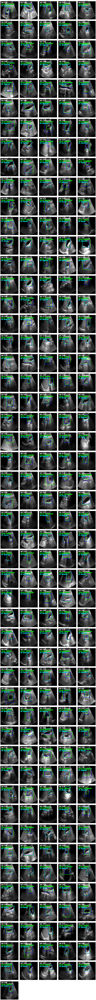

In [7]:
###############################################################################
# PART 5: Model Evaluation and Visualization
###############################################################################

import cv2
import matplotlib.pyplot as plt
import math

# ---------------------------
# 1. Evaluate the Model on the Test Set (224×224)
# ---------------------------
print("Evaluating model on test set...")
eval_results = model.evaluate(
    X_test_224, 
    {'bbox': y_test_bbox_224, 'detection': y_test_label_224},
    verbose=1
)
print("\nTest Evaluation Results:")
for metric_name, value in zip(model.metrics_names, eval_results):
    print(f"{metric_name}: {value:.4f}")

# ---------------------------
# 2. Utility Functions for Visualization
# ---------------------------
def denormalize_bbox(bbox, img_w, img_h):
    """
    Convert a normalized bounding box [x, y, w, h] to pixel coordinates
    [x_min, y_min, x_max, y_max] based on image width and height.
    """
    x_min = int(bbox[0] * img_w)
    y_min = int(bbox[1] * img_h)
    x_max = int((bbox[0] + bbox[2]) * img_w)
    y_max = int((bbox[1] + bbox[3]) * img_h)
    return [x_min, y_min, x_max, y_max]

def compute_iou(boxA, boxB):
    """
    Compute the Intersection over Union (IoU) between two bounding boxes.
    Boxes are defined as [x_min, y_min, x_max, y_max].
    """
    xA = max(boxA[0], boxB[0])
    yA = max(boxA[1], boxB[1])
    xB = min(boxA[2], boxB[2])
    yB = min(boxA[3], boxB[3])
    interArea = max(0, xB - xA) * max(0, yB - yA)
    areaA = (boxA[2] - boxA[0]) * (boxA[3] - boxA[1])
    areaB = (boxB[2] - boxB[0]) * (boxB[3] - boxB[1])
    unionArea = areaA + areaB - interArea + 1e-7
    return interArea / unionArea

# ---------------------------
# 3. Prediction and Visualization on Test Samples
# ---------------------------
print("Making predictions and visualizing results on the test set...")

# Predict using the test set
preds = model.predict(X_test_224)
pred_bbox_all = preds[0]        # Bounding box predictions
pred_detection_all = preds[1]   # Detection (classification) predictions

# Fixed IoU threshold to decide detection outcome
iou_threshold = 0.5

# Visualization settings
disp_w, disp_h = 224, 224
num_test = len(X_test_224)
cols = 5
rows = math.ceil(num_test / cols)
plt.figure(figsize=(cols * 4, rows * 4))

for i in range(num_test):
    # Test image (224x224)
    img = X_test_224[i]
    
    # Get ground truth normalized bbox and denormalize it for display
    gt_bbox_norm = y_test_bbox_224[i]
    gt_box = denormalize_bbox(gt_bbox_norm, disp_w, disp_h)
    
    # Get predicted normalized bbox and denormalize it
    pred_bbox_norm = pred_bbox_all[i]
    pred_box = denormalize_bbox(pred_bbox_norm, disp_w, disp_h)
    
    # Compute IoU between predicted and ground truth bounding boxes
    iou_val = compute_iou(gt_box, pred_box)
    
    # Determine detection outcome based on IoU threshold
    detection_text = "Cancer Detected" if iou_val >= iou_threshold else "Cancer Not Detected"
    
    # Determine true label for visualization: "Abnormal" if label==1, "Normal" otherwise
    true_label_text = "Abnormal" if y_test_label_224[i] == 1 else "Normal"
    
    # Prepare the display image
    disp_img = (img * 255).astype(np.uint8).copy()
    
    # Draw ground truth bounding box in green
    cv2.rectangle(disp_img, (gt_box[0], gt_box[1]), (gt_box[2], gt_box[3]), (0, 255, 0), 2)
    # Draw predicted bounding box in blue
    cv2.rectangle(disp_img, (pred_box[0], pred_box[1]), (pred_box[2], pred_box[3]), (255, 0, 0), 2)
    
    # Set up text properties
    font = cv2.FONT_HERSHEY_SIMPLEX
    font_scale = 0.5
    thickness = 2
    
    # Overlay IoU value
    text_iou = f"IoU: {iou_val:.2f}"
    cv2.putText(disp_img, text_iou, (10, 20), font, font_scale, (0,0,0), thickness+1, cv2.LINE_AA)
    cv2.putText(disp_img, text_iou, (10, 20), font, font_scale, (255,255,255), thickness, cv2.LINE_AA)
    
    # Overlay detection result
    cv2.putText(disp_img, detection_text, (10, 40), font, font_scale, (0,0,0), thickness+1, cv2.LINE_AA)
    cv2.putText(disp_img, detection_text, (10, 40), font, font_scale, (0,255,0), thickness, cv2.LINE_AA)
    
    # Overlay ground truth label
    cv2.putText(disp_img, f"GT: {true_label_text}", (10, 60), font, font_scale, (0,0,0), thickness+1, cv2.LINE_AA)
    cv2.putText(disp_img, f"GT: {true_label_text}", (10, 60), font, font_scale, (255,255,0), thickness, cv2.LINE_AA)
    
    plt.subplot(rows, cols, i+1)
    plt.imshow(cv2.cvtColor(disp_img, cv2.COLOR_BGR2RGB))
    plt.title(f"Test Img {i+1}", fontsize=8)
    plt.axis('off')

plt.tight_layout()
plt.show()


Detection Branch Evaluation Metrics:
Accuracy:  0.8725
Precision: 0.9182
Recall:    0.8848
F1 Score:  0.9012

Confusion Matrix:
[[ 73  13]
 [ 19 146]]


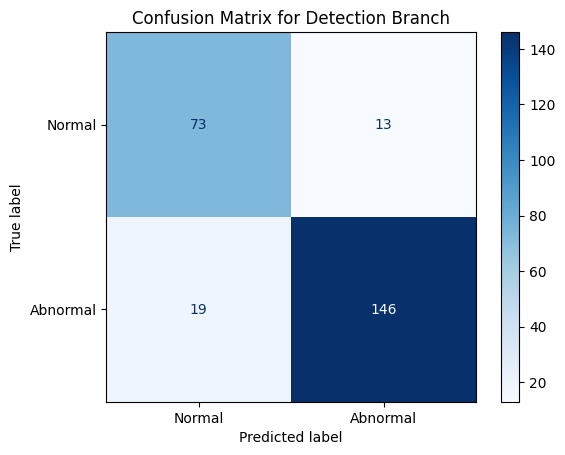

In [8]:
###############################################################################
# PART 6: Evaluation Metrics and Confusion Matrix for the Detection Branch
###############################################################################

import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay, accuracy_score, precision_score, recall_score, f1_score

# Threshold detection probabilities to obtain binary labels.
# Here, a probability >= 0.5 is considered as a positive (Abnormal) detection.
pred_detection_labels = (pred_detection_all >= 0.5).astype(int).flatten()

# Compute evaluation metrics
accuracy = accuracy_score(y_test_label_224, pred_detection_labels)
precision = precision_score(y_test_label_224, pred_detection_labels)
recall = recall_score(y_test_label_224, pred_detection_labels)
f1 = f1_score(y_test_label_224, pred_detection_labels)

print("Detection Branch Evaluation Metrics:")
print(f"Accuracy:  {accuracy:.4f}")
print(f"Precision: {precision:.4f}")
print(f"Recall:    {recall:.4f}")
print(f"F1 Score:  {f1:.4f}")

# Compute and display confusion matrix
conf_matrix = confusion_matrix(y_test_label_224, pred_detection_labels)
print("\nConfusion Matrix:")
print(conf_matrix)

# Plot confusion matrix
disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix, display_labels=["Normal", "Abnormal"])
disp.plot(cmap=plt.cm.Blues)
plt.title("Confusion Matrix for Detection Branch")
plt.show()


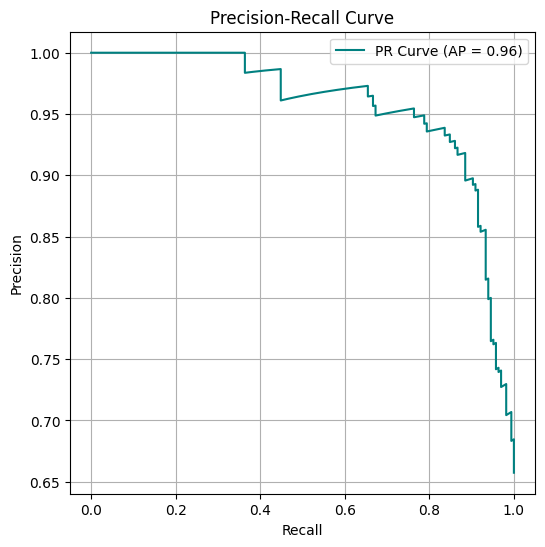

In [9]:
from sklearn.metrics import precision_recall_curve, average_precision_score

precision, recall, _ = precision_recall_curve(y_test_label_224, pred_detection_all.flatten())
avg_precision = average_precision_score(y_test_label_224, pred_detection_all.flatten())

plt.figure(figsize=(6,6))
plt.plot(recall, precision, label=f'PR Curve (AP = {avg_precision:.2f})', color='teal')
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('Precision-Recall Curve')
plt.legend(loc='upper right')
plt.grid(True)
plt.show()


/usr/local/lib/python3.10/dist-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/usr/local/lib/python3.10/dist-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


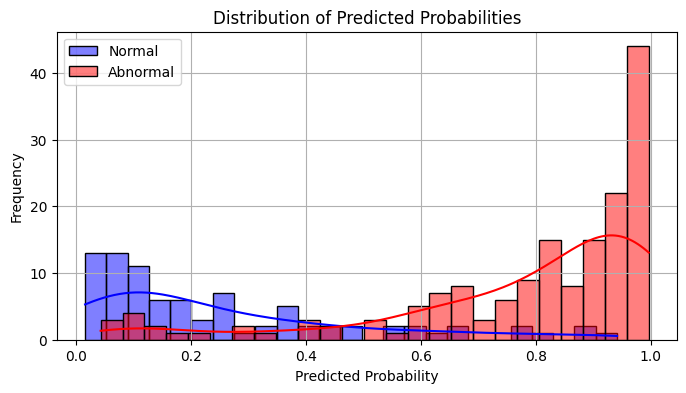

In [10]:
import seaborn as sns

# Prepare data
pred_probs = pred_detection_all.flatten()
true_labels = y_test_label_224

plt.figure(figsize=(8, 4))
sns.histplot(pred_probs[true_labels==0], color='blue', label='Normal', kde=True, bins=25)
sns.histplot(pred_probs[true_labels==1], color='red', label='Abnormal', kde=True, bins=25)
plt.title('Distribution of Predicted Probabilities')
plt.xlabel('Predicted Probability')
plt.ylabel('Frequency')
plt.legend()
plt.grid(True)
plt.show()


Detection Branch Evaluation Metrics:
Accuracy:  0.8725
Precision: 0.9182
Recall:    0.8848
F1 Score:  0.9012

Confusion Matrix:
[[ 73  13]
 [ 19 146]]


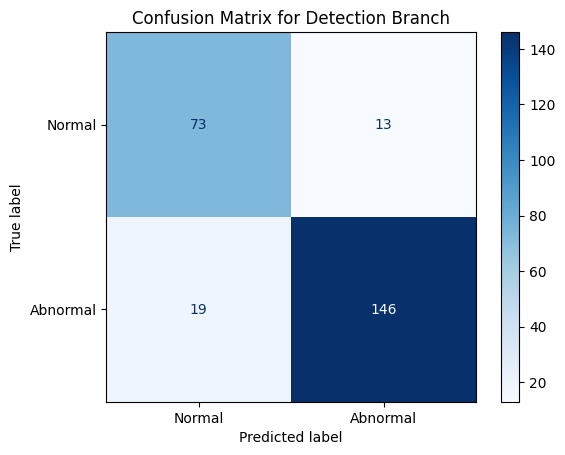

In [11]:
###############################################################################
# PART 6: Evaluation Metrics and Confusion Matrix for the Detection Branch
###############################################################################

import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay, accuracy_score, precision_score, recall_score, f1_score

# Threshold detection probabilities to obtain binary labels.
# Here, a probability >= 0.5 is considered as a positive (Abnormal) detection.
pred_detection_labels = (pred_detection_all >= 0.5).astype(int).flatten()

# Compute evaluation metrics
accuracy = accuracy_score(y_test_label_224, pred_detection_labels)
precision = precision_score(y_test_label_224, pred_detection_labels)
recall = recall_score(y_test_label_224, pred_detection_labels)
f1 = f1_score(y_test_label_224, pred_detection_labels)

print("Detection Branch Evaluation Metrics:")
print(f"Accuracy:  {accuracy:.4f}")
print(f"Precision: {precision:.4f}")
print(f"Recall:    {recall:.4f}")
print(f"F1 Score:  {f1:.4f}")

# Compute and display confusion matrix
conf_matrix = confusion_matrix(y_test_label_224, pred_detection_labels)
print("\nConfusion Matrix:")
print(conf_matrix)

# Plot confusion matrix
disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix, display_labels=["Normal", "Abnormal"])
disp.plot(cmap=plt.cm.Blues)
plt.title("Confusion Matrix for Detection Branch")
plt.show()
